In [1]:
!pip install -U git+https://github.com/qubvel/efficientnet
!pip install git+https://github.com/qubvel/classification_models.git of the current session

  Cloning https://github.com/qubvel/efficientnet to /tmp/pip-req-build-nvuws915
     |████████████████████████████████| 50 kB 271 kB/s 
  Created wheel for efficientnet: filename=efficientnet-1.1.0-py3-none-any.whl size=18422 sha256=5fac6e1b7985e3e80cd18e7603d4861fb4dfc29ca338e42241e1957dfc346091
  Stored in directory: /tmp/pip-ephem-wheel-cache-7ov55li2/wheels/11/69/85/814d64d694c96db0eef17b718042d644a1e54f113920481920
Successfully built efficientnet
  Cloning https://github.com/qubvel/classification_models.git to /tmp/pip-req-build-wcioi8ai
     |████████████████████████████████| 77 kB 373 kB/s 
ERROR: Could not find a version that satisfies the requirement session (from versions: none)
ERROR: No matching distribution found for session


In [2]:
from __future__ import absolute_import, division, print_function, unicode_literals
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import model_from_json
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import efficientnet.tfkeras as efn 
import tensorflow.keras.layers as L
from tensorflow.keras.models import Model

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adadelta
from sklearn.datasets import load_files
from skmultilearn.model_selection import iterative_train_test_split

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))


/kaggle/input/garbage-classification/one-indexed-files-notrash_val.txt
/kaggle/input/garbage-classification/zero-indexed-files.txt
/kaggle/input/garbage-classification/one-indexed-files.txt
/kaggle/input/garbage-classification/one-indexed-files-notrash_test.txt
/kaggle/input/garbage-classification/one-indexed-files-notrash_train.txt
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash72.jpg
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash52.jpg
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash23.jpg
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash120.jpg
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash37.jpg
/kaggle/input/garbage-classification/Garbage classification/Garbage classification/trash/trash54.jpg
/kaggle/input/garbage-classification/Garbage classificatio

In [3]:
train_datagen = ImageDataGenerator(
                    rescale=1./255,
                    rotation_range=45,
                    width_shift_range=.15,
                    height_shift_range=.15,
                    horizontal_flip=True,
                    zoom_range=0.5
                    )


test_datagen = ImageDataGenerator(rescale = 1./255, validation_split=0.1)


In [4]:
X_train = train_datagen.flow_from_directory('/kaggle/input/garbage-classification/garbage classification/Garbage classification/',
                                    target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'sparse')

X_test = test_datagen.flow_from_directory('/kaggle/input/garbage-classification/garbage classification/Garbage classification/',
                          target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'sparse')

Found 2527 images belonging to 6 classes.
Found 2527 images belonging to 6 classes.


In [5]:
dim = 64, 64

def wasteModel(input_dim, base_model):
    
    input_tensor = L.Input(input_dim)
    curr_output  = base_model(input_tensor)
    curr_output  = L.GlobalAveragePooling2D()(curr_output)
    oputput      = L.Dense(6,activation='softmax')(curr_output)
    model = Model(input_tensor, oputput)
    return model

# base model
efnet = efn.EfficientNetB1(weights='imagenet', include_top = False, 
                           input_shape=(*dim, 3))

efnet.trainable = False


# building the complete model
model = wasteModel(input_dim=(*dim,3), base_model = efnet)



27164672/27164032 [==============================] - 1s 0us/step


In [6]:
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)
mc = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='min', save_best_only=True)

cd = [es, mc]

In [7]:
model.compile(loss='sparse_categorical_crossentropy',
              optimizer='Adadelta',
              metrics=['sparse_categorical_accuracy'])

In [8]:
model.fit_generator(
    X_train,
    steps_per_epoch=X_train.samples//X_train.batch_size,
    epochs=1000,
    callbacks=cd,
    validation_data=X_test,
    validation_steps=X_test.samples//X_test.batch_size)

Epoch 1/1000
78/78 [==============================] - 26s 336ms/step - loss: 1.9521 - sparse_categorical_accuracy: 0.1295 - val_loss: 1.9492 - val_sparse_categorical_accuracy: 0.1334
Epoch 2/1000
78/78 [==============================] - 22s 281ms/step - loss: 1.9424 - sparse_categorical_accuracy: 0.1287 - val_loss: 1.9449 - val_sparse_categorical_accuracy: 0.1358
Epoch 3/1000
78/78 [==============================] - 21s 267ms/step - loss: 1.9452 - sparse_categorical_accuracy: 0.1263 - val_loss: 1.9410 - val_sparse_categorical_accuracy: 0.1410
Epoch 4/1000
78/78 [==============================] - 21s 265ms/step - loss: 1.9291 - sparse_categorical_accuracy: 0.1419 - val_loss: 1.9348 - val_sparse_categorical_accuracy: 0.1438
Epoch 5/1000
78/78 [==============================] - 22s 280ms/step - loss: 1.9203 - sparse_categorical_accuracy: 0.1347 - val_loss: 1.9306 - val_sparse_categorical_accuracy: 0.1474
Epoch 6/1000
78/78 [==============================] - 21s 274ms/step - loss: 1.9266 -

In [9]:
model.save("new_model.h5")

In [10]:
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)
model.save_weights("model.h5")
print("Saved model to disk")

Saved model to disk


In [11]:
from PIL import Image
import numpy as np
from skimage import transform
import matplotlib.pyplot as plt

def load(filename):
   np_image = Image.open(filename)
   np_image = np.array(np_image).astype('float32')/255
   np_image = transform.resize(np_image, (64, 64, 3))
   np_image = np.expand_dims(np_image, axis=0)
   return np_image

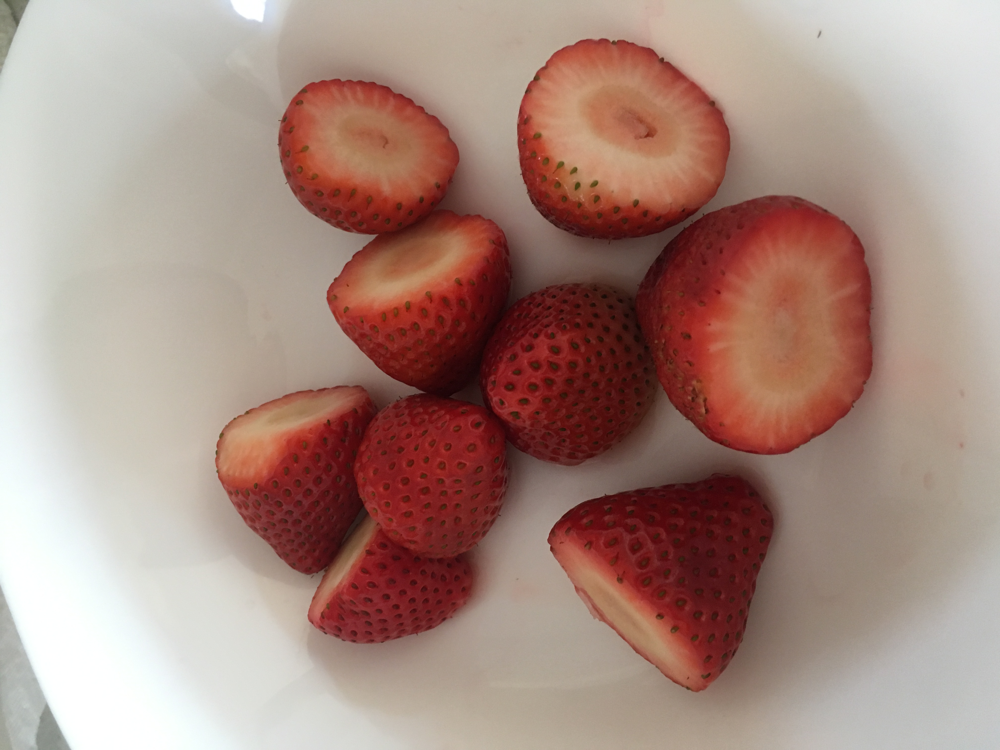

In [12]:
Image.open('/kaggle/input/more-test-images/IMG-7974.JPG')

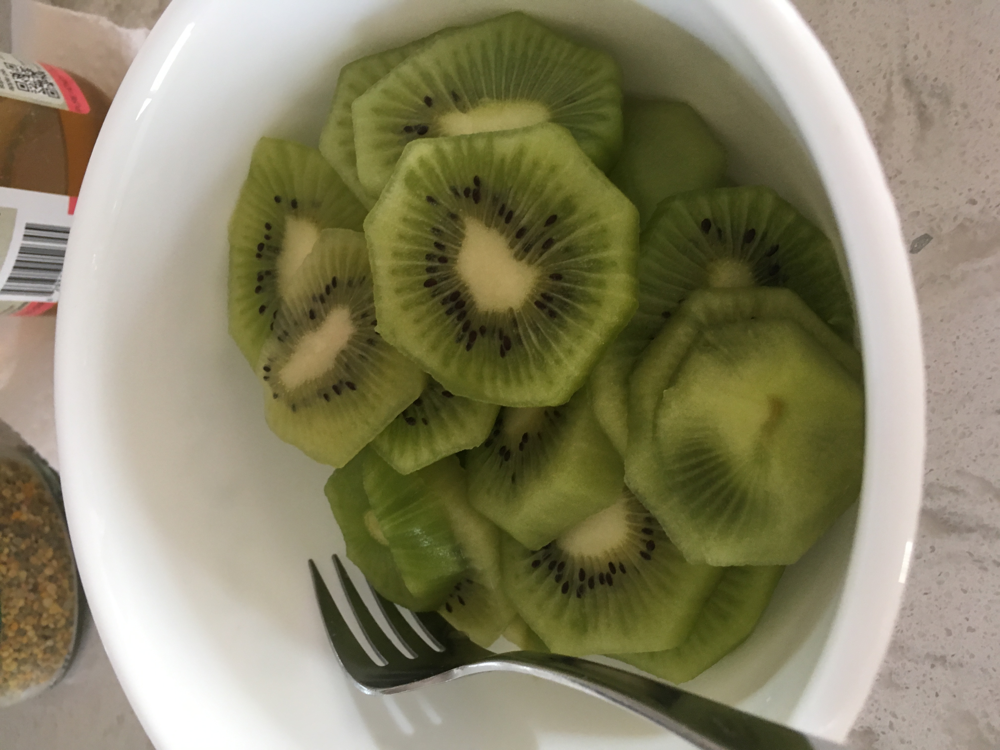

In [13]:
Image.open('/kaggle/input/more-test-images/IMG-7976.JPG')

In [14]:
image1 = load('/kaggle/input/more-test-images/IMG-7974.JPG')
image2 = load('/kaggle/input/more-test-images/IMG-7976.JPG')
image3 = load('/kaggle/input/more-test-images/images.jpeg')
image4 = load('/kaggle/input/more-test-images/Screen-Shot-2019-05-22-at-10.27.26-AM (1).jpg')


In [15]:
prediction1 = model.predict_classes(image1)
print(prediction1)

AttributeError: 'Functional' object has no attribute 'predict_classes'

In [16]:
prediction2 = model.predict_classes(image2)
print(prediction2)


AttributeError: 'Functional' object has no attribute 'predict_classes'

In [17]:
prediction3 = model.predict_classes(image3)
print(prediction3)


AttributeError: 'Functional' object has no attribute 'predict_classes'

In [18]:
prediction4 = model.predict_classes(image4)
print(prediction4)

AttributeError: 'Functional' object has no attribute 'predict_classes'

In [19]:
X_train.class_indices

{'cardboard': 0, 'glass': 1, 'metal': 2, 'paper': 3, 'plastic': 4, 'trash': 5}

In [20]:
def prediction(result):
    if result == 0:
        prediction = "metal"
    elif result == 1:
        prediction = "paper"
    elif result == 2:
        prediction = "plastic"
    elif result == 3:
        prediction = "glass"
    elif result == 4:
        prediction = "trash"
    elif result == 5:
        prediction = "cardboard"
    else:
        prediction = "error"
    return prediction

In [21]:
prediction(prediction1)

NameError: name 'prediction1' is not defined

In [22]:
prediction(prediction2)

NameError: name 'prediction2' is not defined

In [23]:
prediction(prediction3)

NameError: name 'prediction3' is not defined

In [24]:
prediction(prediction4)


NameError: name 'prediction4' is not defined

In [25]:
def total(filename):
    image = load(filename)
    result = model.predict_classes(image)
    return prediction(result)


In [26]:
total('/kaggle/input/more-test-images/IMG-7974.JPG')


AttributeError: 'Functional' object has no attribute 'predict_classes'

In [27]:
total('/kaggle/input/more-test-images/IMG-7976.JPG')


AttributeError: 'Functional' object has no attribute 'predict_classes'

In [28]:
total('/kaggle/input/more-test-images/images.jpeg')


AttributeError: 'Functional' object has no attribute 'predict_classes'

In [29]:
total('/kaggle/input/more-test-images/Screen-Shot-2019-05-22-at-10.27.26-AM (1).jpg')

AttributeError: 'Functional' object has no attribute 'predict_classes'